# First lets predict the average price of avacados

# 1. Import Necessary Libraries

In [105]:
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
import sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import GridSearchCV

from sklearn.model_selection import train_test_split

from sklearn.metrics import roc_curve, auc,classification_report,accuracy_score
from sklearn.metrics import mean_squared_error ,mean_absolute_error,log_loss
from sklearn.metrics import confusion_matrix

import warnings
warnings.filterwarnings('ignore')

# 2. Read In and Explore the Data

In [106]:
#converting into dataframe
df = pd.read_csv('avocado.csv')

In [107]:
df.shape

(18249, 14)

In [108]:
df.drop('Unnamed: 0',axis=1,inplace=True)

In [109]:
df.describe()

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year
count,18249.000000,1.824900e+04,1.824900e+04,1.824900e+04,1.824900e+04,1.824900e+04,1.824900e+04,1.824900e+04,18249.000000,18249.000000
mean,1.405978,8.506440e+05,2.930084e+05,2.951546e+05,2.283974e+04,2.396392e+05,1.821947e+05,5.433809e+04,3106.426507,2016.147899
std,0.402677,3.453545e+06,1.264989e+06,1.204120e+06,1.074641e+05,9.862424e+05,7.461785e+05,2.439660e+05,17692.894652,0.939938
min,0.440000,8.456000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,2015.000000
25%,1.100000,1.083858e+04,8.540700e+02,3.008780e+03,0.000000e+00,5.088640e+03,2.849420e+03,1.274700e+02,0.000000,2015.000000
50%,1.370000,1.073768e+05,8.645300e+03,2.906102e+04,1.849900e+02,3.974383e+04,2.636282e+04,2.647710e+03,0.000000,2016.000000
75%,1.660000,4.329623e+05,1.110202e+05,1.502069e+05,6.243420e+03,1.107834e+05,8.333767e+04,2.202925e+04,132.500000,2017.000000
max,3.250000,6.250565e+07,2.274362e+07,2.047057e+07,2.546439e+06,1.937313e+07,1.338459e+07,5.719097e+06,551693.650000,2018.000000


In [110]:
df.head(10)

,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
5,2015-11-22,1.26,55979.78,1184.27,48067.99,43.61,6683.91,6556.47,127.44,0.0,conventional,2015,Albany
6,2015-11-15,0.99,83453.76,1368.92,73672.72,93.26,8318.86,8196.81,122.05,0.0,conventional,2015,Albany
7,2015-11-08,0.98,109428.33,703.75,101815.36,80.00,6829.22,6266.85,562.37,0.0,conventional,2015,Albany
8,2015-11-01,1.02,99811.42,1022.15,87315.57,85.34,11388.36,11104.53,283.83,0.0,conventional,2015,Albany
9,2015-10-25,1.07,74338.76,842.40,64757.44,113.00,8625.92,8061.47,564.45,0.0,conventional,2015,Albany


### Imputing Missing Values with Medians

In [50]:
df.isnull().sum()

Date            0
AveragePrice    0
Total Volume    0
4046            0
4225            0
4770            0
Total Bags      0
Small Bags      0
Large Bags      0
XLarge Bags     0
type            0
year            0
region          0
dtype: int64

In [51]:
df.dtypes

Date             object
AveragePrice    float64
Total Volume    float64
4046            float64
4225            float64
4770            float64
Total Bags      float64
Small Bags      float64
Large Bags      float64
XLarge Bags     float64
type             object
year              int64
region           object
dtype: object

In [52]:
df['region'].value_counts()

Columbus               338
HarrisburgScranton     338
GrandRapids            338
California             338
Orlando                338
Nashville              338
RaleighGreensboro      338
GreatLakes             338
SouthCentral           338
Seattle                338
StLouis                338
LasVegas               338
RichmondNorfolk        338
Southeast              338
Northeast              338
Jacksonville           338
Indianapolis           338
West                   338
MiamiFtLauderdale      338
TotalUS                338
HartfordSpringfield    338
SanDiego               338
BuffaloRochester       338
Charlotte              338
Boise                  338
PhoenixTucson          338
Detroit                338
Spokane                338
SouthCarolina          338
DallasFtWorth          338
Sacramento             338
Boston                 338
Denver                 338
Louisville             338
NorthernNewEngland     338
SanFrancisco           338
Portland               338
L

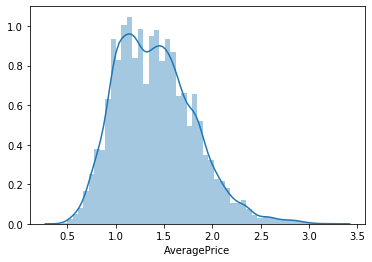

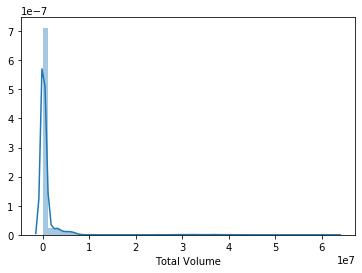

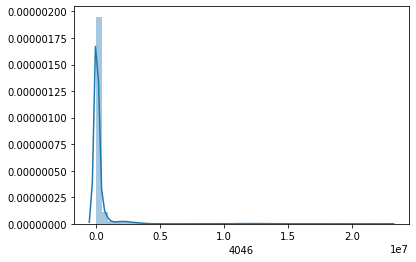

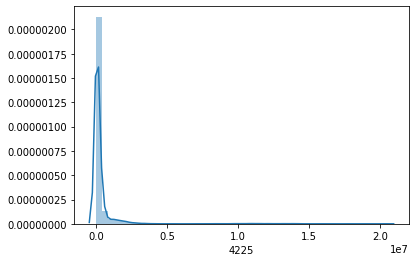

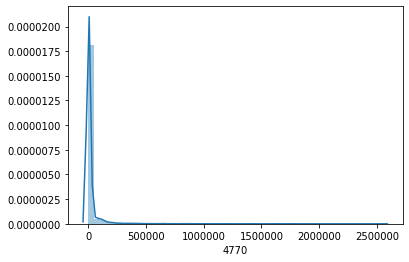

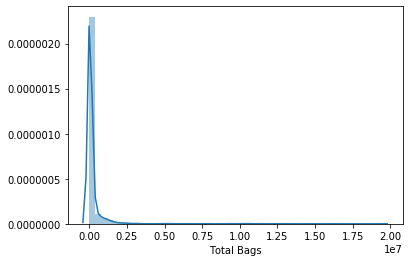

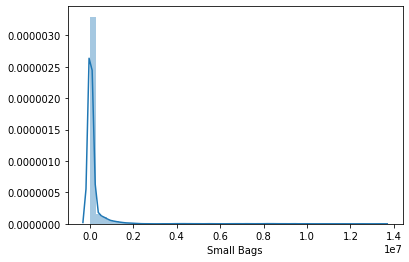

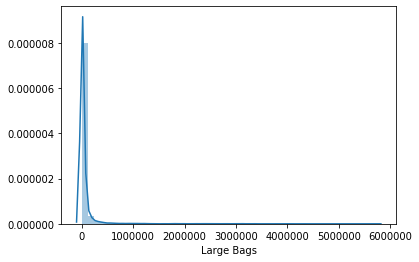

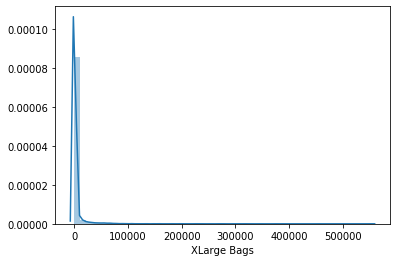

In [20]:
components=df.drop(['Date','region','type','year'],axis=1).columns
for comp in components:
    sns.distplot(df[comp])
    plt.show()

In [111]:
Total_Volume_transformed = np.log(df['Total Volume']+ 1)
Total_Volume_transformed.describe()
df['Total Volume']=Total_Volume_transformed

In [112]:
T4046_transformed = np.log(df['4046']+ 1)
T4046_transformed.describe()
df['4046']=T4046_transformed

In [113]:
Total_4225_transformed = np.log(df['4225']+ 1)
Total_4225_transformed.describe()
df['4225']=Total_4225_transformed

Total_4770_transformed = np.log(df['4770']+ 1)
Total_4770_transformed.describe()
df['4770']=Total_4770_transformed

Total_Bags_transformed = np.log(df['Total Bags']+ 1)
Total_Bags_transformed.describe()
df['Total Bags']=Total_Bags_transformed

Small_Bags_transformed = np.log(df['Small Bags']+ 1)
Total_Volume_transformed.describe()
df['Small Bags']=Small_Bags_transformed

Large_Bags_transformed = np.log(df['Large Bags']+ 1)
Large_Bags_transformed.describe()
df['Large Bags']=Large_Bags_transformed

XLarge_Bags_transformed = np.log(df['XLarge Bags']+ 1)
XLarge_Bags_transformed.describe()
df['XLarge Bags']=XLarge_Bags_transformed

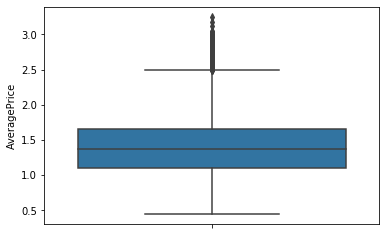

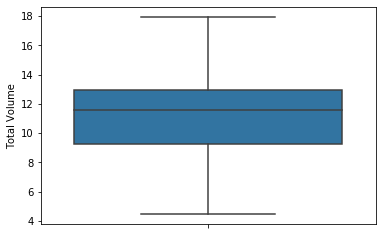

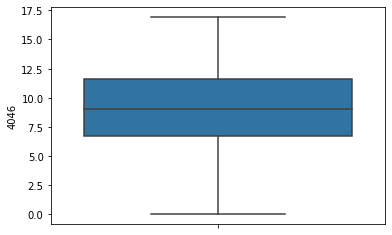

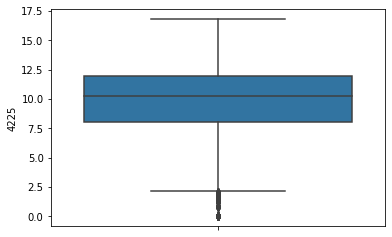

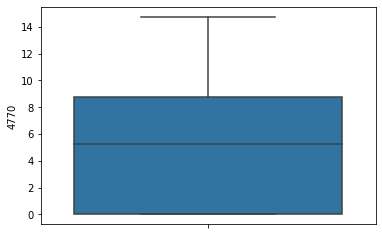

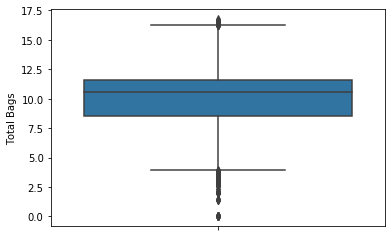

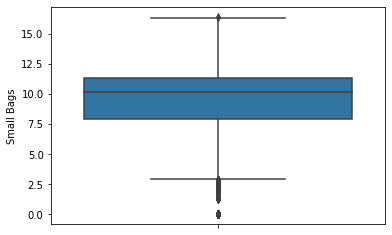

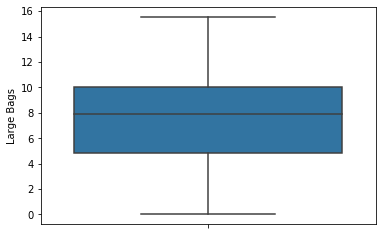

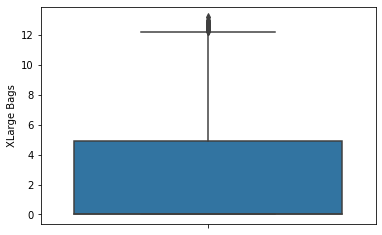

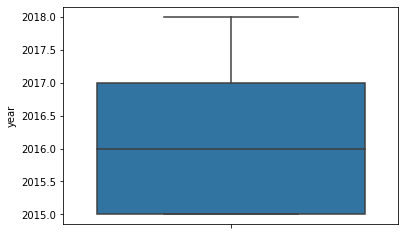

In [56]:
components=df.drop(['Date','region','type'],axis=1).columns
for comp in components:
        sns.boxplot(y=comp,data=df)
        plt.show()

There are few ouliers in error feature

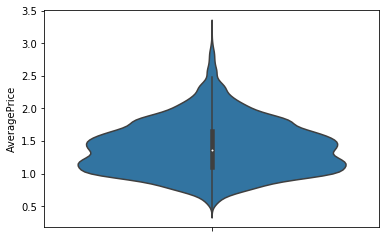

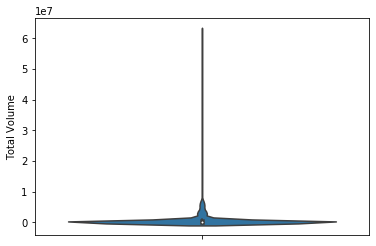

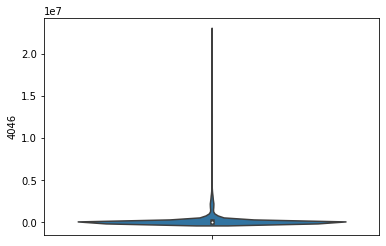

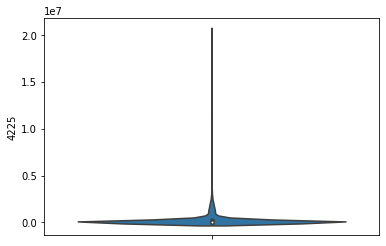

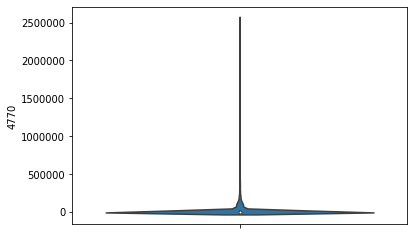

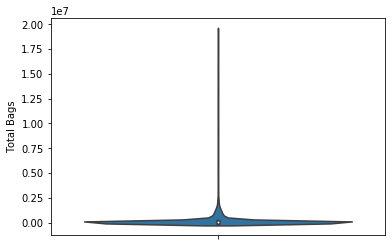

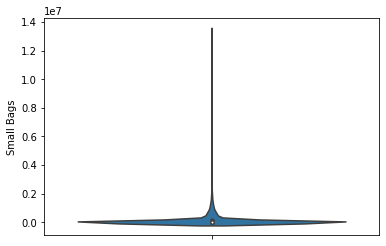

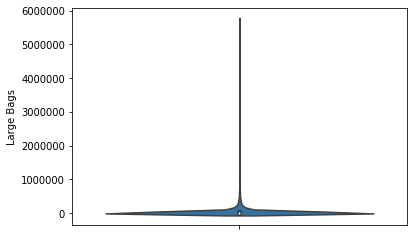

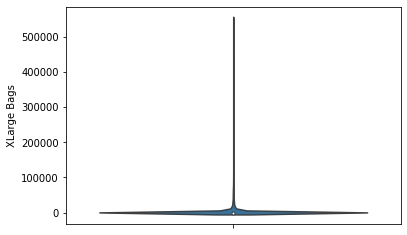

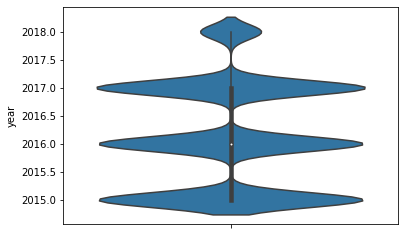

In [35]:
components=df.drop(['Date','region','type'],axis=1).columns
for comp in components:
        sns.violinplot(y=comp,data=df)
        plt.show()

All features seems mostly normal

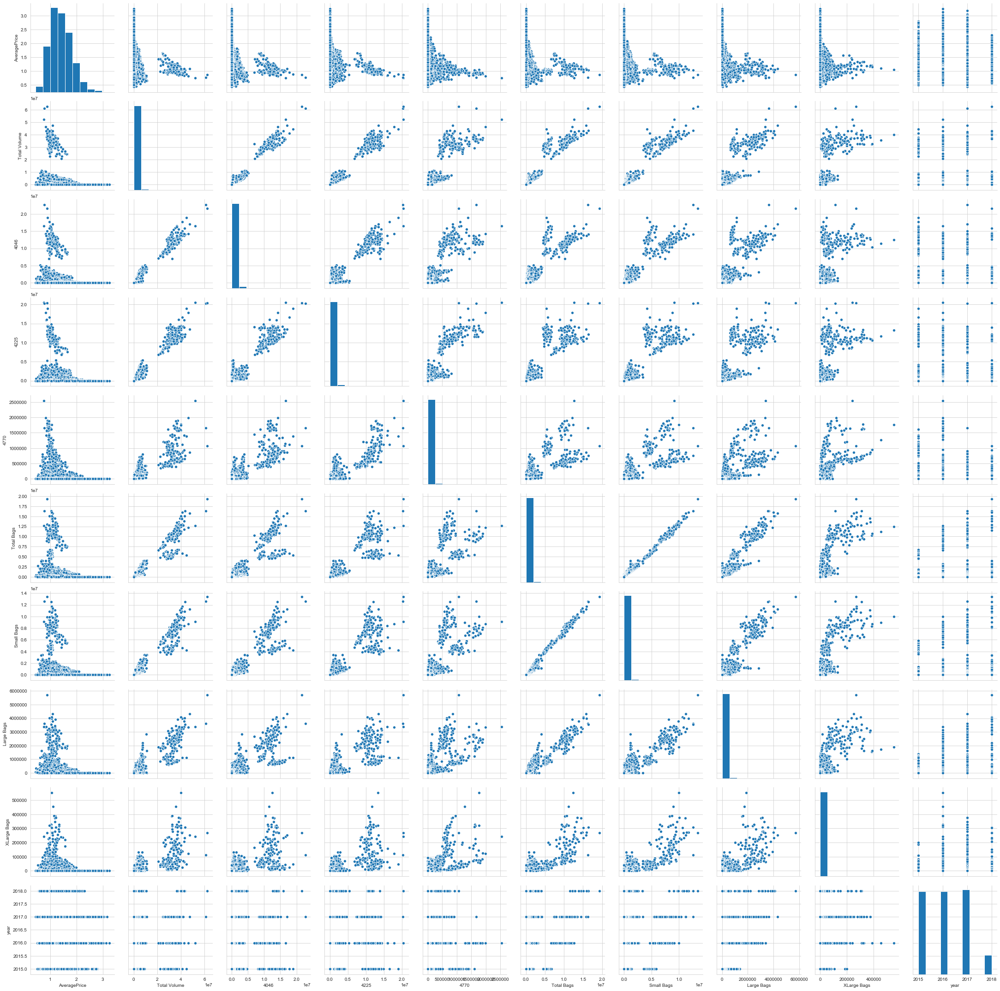

In [36]:
components=df.drop(['Date','region','type'],axis=1).columns

sns.set_style("whitegrid");               #Step1:Set the gird to white.
sns.pairplot(df,vars=components ,height=3); #.pairplot(dataset,hue='',size=n) function to plot pairplot
plt.show()

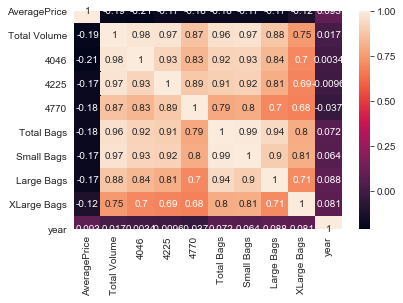

In [37]:
corr=df.drop(['Date','region','type'],axis=1).corr()
sns.heatmap(corr, annot=True)

Summary:<br>
The only co-relation we see is between Runs allowed and Earned Runs

# 4. Data pre-processing and cleaning

## A.Removing Unwanted columns 

In [114]:
df.drop(["Date"], axis = 1, inplace = True) 

In [115]:
df.columns


Index(['AveragePrice', 'Total Volume', '4046', '4225', '4770', 'Total Bags',
       'Small Bags', 'Large Bags', 'XLarge Bags', 'type', 'year', 'region'],
      dtype='object')

In [116]:
df.dtypes

AveragePrice    float64
Total Volume    float64
4046            float64
4225            float64
4770            float64
Total Bags      float64
Small Bags      float64
Large Bags      float64
XLarge Bags     float64
type             object
year              int64
region           object
dtype: object

## A.Converting all features to numerical features 

In [117]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
df['region']=label_encoder.fit_transform(df['region']) 
df['type']= label_encoder.fit_transform(df['type']) 

## B.Removing Outliers

In [118]:
from scipy import stats
z=abs(stats.zscore(df))
print(np.where(z>3))
df=df[(z<3).all(axis=1)]

(array([ 5482,  5483,  5484,  5485,  8344,  8345,  9189,  9190,  9191,
        9192,  9192,  9203,  9204,  9205,  9206,  9211,  9212,  9212,
        9213,  9218,  9219,  9220,  9221,  9293,  9294,  9298,  9668,
        9894,  9894, 10154, 10232, 10234, 10324, 10325, 10326, 10327,
       10331, 10332, 10333, 10334, 10334, 10375, 10377, 10380, 10382,
       10388, 10392, 10397, 10398, 10417, 10419, 10420, 10531, 10532,
       10533, 10534, 10535, 10536, 10562, 10563, 10566, 11011, 11012,
       11014, 11015, 11016, 11017, 11018, 11019, 11020, 11021, 11022,
       11023, 11024, 11024, 11025, 11026, 11027, 11028, 11029, 11030,
       11031, 11032, 11033, 11034, 11035, 11036, 11037, 11039, 11040,
       11041, 11042, 11314, 11316, 11318, 11319, 11320, 11320, 11320,
       11321, 11321, 11321, 11322, 11323, 11324, 11324, 11325, 11325,
       11325, 11326, 11326, 11327, 11327, 11328, 11329, 11329, 11330,
       11330, 11331, 11331, 11332, 11332, 11333, 11333, 11334, 11335,
       11336, 11337

## B. Normalize all features

In [119]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
normalizer.fit(df.drop(['AveragePrice'],axis=1))
df_tran=normalizer.transform(df.drop(['AveragePrice'],axis=1))

In [120]:
df1 = pd.DataFrame(df_tran,columns=df.drop(['AveragePrice'],axis=1).columns)

In [121]:
df1.head()

,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0.005494,0.003446,0.005412,0.001933,0.004501,0.004496,0.002256,0.0,0.0,0.999940,0.0
1,0.005415,0.003233,0.005313,0.002026,0.004546,0.004540,0.002278,0.0,0.0,0.999941,0.0
2,0.005796,0.003315,0.005757,0.002421,0.004469,0.004463,0.002305,0.0,0.0,0.999936,0.0
3,0.005596,0.003490,0.005550,0.002133,0.004301,0.004290,0.002433,0.0,0.0,0.999939,0.0
4,0.005380,0.003399,0.005304,0.002154,0.004332,0.004316,0.002626,0.0,0.0,0.999941,0.0


## D. Train_Test split

In [122]:
y=df['AveragePrice']
x=df.drop(['AveragePrice'],axis=1)

In [123]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

# 5. Building Models

# Model1 : KNN

In [32]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
neigh = KNeighborsRegressor()

parameters = {'n_neighbors': range(1,10,1)}

clf = GridSearchCV(neigh, parameters, cv= 5)

clf.fit(X_train, y_train)



GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=KNeighborsRegressor(algorithm='auto', leaf_size=30,
                                           metric='minkowski',
                                           metric_params=None, n_jobs=None,
                                           n_neighbors=5, p=2,
                                           weights='uniform'),
             iid='warn', n_jobs=None, param_grid={'n_neighbors': range(1, 10)},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

In [33]:
clf.best_params_

{'n_neighbors': 4}

In [34]:
#KNN classifier sklearn : https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score

neigh = KNeighborsRegressor(n_neighbors=4)
neigh.fit(X_train, y_train)

y_test_pred = neigh.predict(X_test)
print(r2_score(y_test,y_test_pred))


0.8243584353270912


# Model 2 : Logistic Regression 

# Model 3 : Linear regression 

In [35]:
from sklearn.linear_model import LinearRegression
Lr = LinearRegression()
Lr.fit(X_train, y_train)

y_test_pred = Lr.predict(X_test)

print(r2_score(y_test,y_test_pred))

0.5417838194228662


# Model 4 : SVM

In [ ]:
from sklearn.svm import SVR

parameters = [{'C': [0.1, 1, 10, 100, 1000],  
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001], 
              'kernel': ['rbf','linear']}]   #'poly','sigmoid' takes too much time

model = GridSearchCV(SVR(),parameters, cv=5)
model.fit(X_train, y_train)    

print(model.best_estimator_)
print(model.score(X_train, y_train))

In [ ]:
model.best_params_

In [180]:
from sklearn.model_selection import cross_val_score

C= [10**-4, 10**-2, 10**0, 10**2, 10**4]
k_scores = []

for k in C:
    #
    svm = SVR(C=k,gamma= 0.0001,kernel='linear')
    
    scores = cross_val_score(svm,X_train, y_train, cv=10)
    
    k_scores.append(scores.mean())
print(k_scores)

[0.9999999986903084, 0.9999999987427742, 0.9999999987427742, 0.9999999987427742, 0.9999999987427742]


In [181]:
import math as mt
log_C=[]
for i in C:
     log_C.append(mt.log10(i))

Text(0, 0.5, 'Cross-Validated Accuracy')

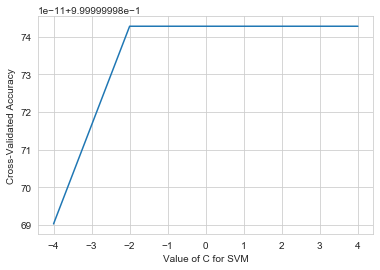

In [182]:
# plot the value of K for KNN (x-axis) versus the cross-validated accuracy (y-axis)
plt.plot(log_C, k_scores)
plt.xlabel('Value of C for SVM')
plt.ylabel('Cross-Validated Accuracy')

In [124]:
from sklearn.svm import SVR

clf = SVR()

clf.fit(X_train, y_train)

y_test_pred = clf.predict(X_test)

print(r2_score(y_test,y_test_pred))

0.8544857824752368


# Model 5 : Decision Tree

In [16]:
#https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor


parameters = {'max_depth': [5, 10, 50, 100]}

clf = DecisionTreeRegressor(criterion='mse')

model = GridSearchCV(clf,parameters,cv=3)

model.fit(X_train, y_train)    

print(model.best_estimator_)
print(model.score(X_train, y_train))


DecisionTreeRegressor(criterion='mse', max_depth=10, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')
0.8171527302086883


In [17]:
model.best_params_

{'max_depth': 10}

In [18]:
from sklearn.model_selection import cross_val_score

max_depth= [1,5,15,25,50]
k_scores = []

for k in max_depth:
    #
    DT = DecisionTreeRegressor(max_depth=k,criterion='mse', min_samples_split=100)
    
    scores = cross_val_score(DT,X_train, y_train, cv=10)
    
    k_scores.append(scores.mean())
print(k_scores)

[0.3780537718728071, 0.5642541073590741, 0.6696725137380637, 0.6694098346782643, 0.6694489651549584]


Text(0, 0.5, 'Cross-Validated Accuracy')

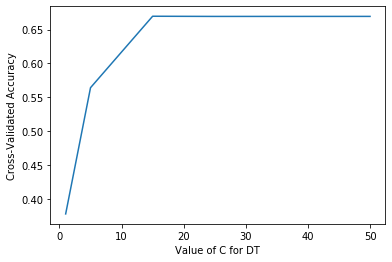

In [19]:
# plot the value of K for KNN (x-axis) versus the cross-validated accuracy (y-axis)
plt.plot(max_depth, k_scores)
plt.xlabel('Value of C for DT')
plt.ylabel('Cross-Validated Accuracy')

# Traning with best hyperparameters

In [37]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score
clf = DecisionTreeRegressor(criterion='mse',max_depth=10,min_samples_split=2)

clf.fit(X_train, y_train)


y_test_pred = clf.predict(X_test)

print(r2_score(y_test,y_test_pred))

0.6802405962902176


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.454441 to fit



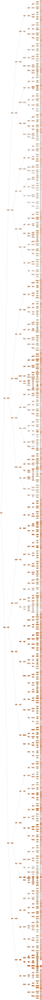

In [22]:
#https://scikit-learn.org/stable/modules/generated/sklearn.tree.export_graphviz.html
import pydotplus
from sklearn.tree import export_graphviz
from IPython.display import Image
from sklearn.externals.six import StringIO

dot_data = StringIO()

export_graphviz(clf, out_file=dot_data, filled=True, rounded=True, special_characters=True, feature_names=X_train.columns,rotate=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

Image(graph.create_png())

# Model 6 : Ensemble Techniques 

### Note: we have very less data points so applying ensemble techniques is not good idea , i did it to just check the performnace improvement 

## A. Bagging

In [38]:
#https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor


parameters = {'max_depth': [5, 10, 50, 100],'n_estimators':[10, 20 , 50, 100]}
RF = RandomForestRegressor( criterion='mse')

model = GridSearchCV(RF,parameters, cv=3)

model.fit(X_train, y_train)    

print(model.best_estimator_)
print(model.score(X_train, y_train))


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=50,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)
0.9776756322695379


In [39]:
from sklearn.model_selection import GridSearchCV

RF=RandomForestRegressor(max_depth=50,n_estimators=100,criterion='mse' )
RF.fit(X_train, y_train)

y_test_pred = RF.predict(X_test)

print(r2_score(y_test,y_test_pred))

0.8360547180768243


# Boosting

In [42]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
clf=GradientBoostingRegressor(max_depth=5,n_estimators=100)
clf.fit(X_train, y_train)

y_test_pred = clf.predict(X_test)

print(r2_score(y_test,y_test_pred))

0.7703737843379036


## Note: As we have very less data stascking is not advisable 

# Xgboost

In [40]:
import xgboost as xgb
xgb_model = xgb.XGBRegressor(random_state=42)

xgb_model.fit(X_train, y_train)


y_test_pred = xgb_model.predict(X_test)

print(r2_score(y_test,y_test_pred))



[22:45:47] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.6838703437946229


# 6.Model Comparison

In [125]:
#https://stackoverflow.com/questions/18601688/python-prettytable-example

from prettytable import PrettyTable
table = PrettyTable()

#setting column names
table.field_names = [ "Model", "r2_score"]

#setting row values
table.add_row(["KNN", '0.8243' ])
table.add_row(["Linear Regression" ,'0.5417' ])
table.add_row(["SVM", '0.8544' ])
table.add_row(["Decision Tree",'0.6838' ])
table.add_row(["RandomForest",'0.8368' ])
table.add_row(["GBDT" ,'0.7703' ])
table.add_row(["Xgboost",'0.6838' ])
print(table)

+-------------------+----------+
|       Model       | r2_score |
+-------------------+----------+
|        KNN        |  0.8243  |
| Linear Regression |  0.5417  |
|        SVM        |  0.8544  |
|   Decision Tree   |  0.6838  |
|    RandomForest   |  0.8368  |
|        GBDT       |  0.7703  |
|      Xgboost      |  0.6838  |
+-------------------+----------+


Summary:<br>
1.Even simple models like SVM performs very well , so we use SVM as final model.   

# 7.Creating Submission File

In [126]:
best_model=SVC
from sklearn.externals import joblib
filename = 'finalized_model.sav'
joblib.dump(best_model, filename)

['finalized_model.sav']

## Now We find the city or region the avocado belongs to

# 1. Data pre-processing and cleaning

## A.Removing Unwanted columns 

In [57]:
df.drop(["Date"], axis = 1, inplace = True) 

In [58]:
df.columns


Index(['AveragePrice', 'Total Volume', '4046', '4225', '4770', 'Total Bags',
       'Small Bags', 'Large Bags', 'XLarge Bags', 'type', 'year', 'region'],
      dtype='object')

In [59]:
df.dtypes

AveragePrice    float64
Total Volume    float64
4046            float64
4225            float64
4770            float64
Total Bags      float64
Small Bags      float64
Large Bags      float64
XLarge Bags     float64
type             object
year              int64
region           object
dtype: object

## B.Converting all features to numerical features 

In [81]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
df['region']=label_encoder.fit_transform(df['region']) 
df['type']= label_encoder.fit_transform(df['type']) 

## C.Removing Outliers

In [82]:
from scipy import stats
z=abs(stats.zscore(df))
print(np.where(z>3))
df=df[(z<3).all(axis=1)]

(array([ 5482,  5483,  5484,  5485,  8344,  8345,  9189,  9190,  9191,
        9192,  9192,  9203,  9204,  9205,  9206,  9211,  9212,  9212,
        9213,  9218,  9219,  9220,  9221,  9293,  9294,  9298,  9668,
        9894,  9894, 10154, 10232, 10234, 10324, 10325, 10326, 10327,
       10331, 10332, 10333, 10334, 10334, 10375, 10377, 10380, 10382,
       10388, 10392, 10397, 10398, 10417, 10419, 10420, 10531, 10532,
       10533, 10534, 10535, 10536, 10562, 10563, 10566, 11011, 11012,
       11014, 11015, 11016, 11017, 11018, 11019, 11020, 11021, 11022,
       11023, 11024, 11024, 11025, 11026, 11027, 11028, 11029, 11030,
       11031, 11032, 11033, 11034, 11035, 11036, 11037, 11039, 11040,
       11041, 11042, 11314, 11316, 11318, 11319, 11320, 11320, 11320,
       11321, 11321, 11321, 11322, 11323, 11324, 11324, 11325, 11325,
       11325, 11326, 11326, 11327, 11327, 11328, 11329, 11329, 11330,
       11330, 11331, 11331, 11332, 11332, 11333, 11333, 11334, 11335,
       11336, 11337

## D. Normalize all features

In [83]:
from sklearn.preprocessing import Normalizer
normalizer = Normalizer()
normalizer.fit(df.drop(['region'],axis=1))
df_tran=normalizer.transform(df.drop(['region'],axis=1))

In [84]:
df1 = pd.DataFrame(df_tran,columns=df.drop(['region'],axis=1).columns)

In [85]:
df1.head()

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year
0,0.000660,0.005494,0.003446,0.005412,0.001933,0.004501,0.004496,0.002256,0.0,0.0,0.999939
1,0.000670,0.005415,0.003233,0.005313,0.002026,0.004546,0.004540,0.002278,0.0,0.0,0.999940
2,0.000462,0.005796,0.003315,0.005757,0.002421,0.004469,0.004463,0.002305,0.0,0.0,0.999935
3,0.000536,0.005596,0.003490,0.005550,0.002133,0.004301,0.004290,0.002433,0.0,0.0,0.999939
4,0.000635,0.005380,0.003399,0.005304,0.002154,0.004332,0.004316,0.002626,0.0,0.0,0.999941


## E. Train_Test split

In [86]:
y=df['region']
x=df.drop(['region'],axis=1)

In [87]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

In [67]:
from sklearn import preprocessing
y_train = preprocessing.label_binarize(y_train,classes=[0, 1, 2, 3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52])
y_test= preprocessing.label_binarize(y_test,classes=[0, 1, 2, 3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52])

# 5. Building Models

# Model1 : KNN

In [68]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV

neigh = KNeighborsClassifier()

parameters = {'n_neighbors': range(1,100,10)}

clf = GridSearchCV(neigh, parameters, cv=10, scoring='roc_auc')

clf.fit(X_train, y_train)



GridSearchCV(cv=10, error_score='raise-deprecating',
             estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30,
                                            metric='minkowski',
                                            metric_params=None, n_jobs=None,
                                            n_neighbors=5, p=2,
                                            weights='uniform'),
             iid='warn', n_jobs=None,
             param_grid={'n_neighbors': range(1, 100, 10)},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring='roc_auc', verbose=0)

In [69]:
clf.best_params_

{'n_neighbors': 21}

In [ ]:
from sklearn.model_selection import cross_val_score
k_range = range(1,100,10)
k_scores = []


for k in k_range:
  
    knn = KNeighborsClassifier(n_neighbors=k)
    
    scores = cross_val_score(knn,X_train, y_train, cv=10, scoring='accuracy')
   
    k_scores.append(scores.mean())
print(k_scores)

Text(0, 0.5, 'Cross-Validated Accuracy')

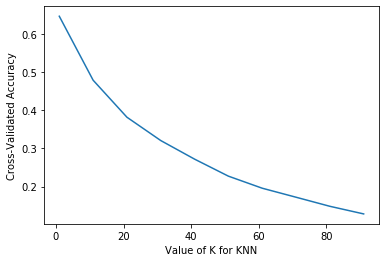

In [65]:
# plot the value of K for KNN (x-axis) versus the cross-validated accuracy (y-axis)
plt.plot(k_range, k_scores)
plt.xlabel('Value of K for KNN')
plt.ylabel('Cross-Validated Accuracy')

# Classification Report

In [70]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=21)
neigh.fit(X_train, y_train)

y_pred=neigh.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.83      0.77      0.80       121
           1       0.90      0.45      0.60        95
           2       0.89      0.81      0.85       113
           3       0.90      0.58      0.71        98
           4       0.90      0.62      0.74       119
           5       0.81      0.43      0.56       118
           6       0.95      0.81      0.88       117
           7       0.89      0.73      0.81       116
           8       0.94      0.85      0.89       111
           9       0.92      0.56      0.70       124
          10       0.90      0.30      0.45       125
          11       0.95      0.69      0.80       118
          12       0.99      0.80      0.88       105
          13       0.81      0.52      0.63        98
          14       0.92      0.76      0.83       107
          15       0.96      0.88      0.92       123
          16       0.93      0.73      0.82       120
          17       0.87    

# Model 2 : Naive Bayes

In [88]:
from sklearn.naive_bayes import MultinomialNB

mnb = MultinomialNB()
mnb.fit(X_train, y_train)
y_pred=mnb.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.01      0.00       121
           1       0.00      0.00      0.00        95
           2       0.00      0.00      0.00       113
           3       0.00      0.00      0.00        98
           4       0.02      0.01      0.01       119
           5       0.00      0.00      0.00       118
           6       0.00      0.00      0.00       117
           7       0.17      0.09      0.12       116
           8       0.00      0.00      0.00       111
           9       0.00      0.00      0.00       124
          10       0.00      0.00      0.00       125
          11       0.00      0.00      0.00       118
          12       0.05      0.35      0.09       105
          13       0.00      0.00      0.00        98
          14       0.00      0.00      0.00       107
          15       0.00      0.00      0.00       123
          16       0.00      0.00      0.00       120
          17       0.00    

# Model 3 : Logistic Regression 

In [89]:
from sklearn.metrics import roc_curve, auc
from sklearn.linear_model import LogisticRegression
Lr = LogisticRegression(multi_class='ovr')
Lr.fit(X_train, y_train)
y_pred=Lr.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.72      0.36      0.48       121
           1       0.11      0.19      0.14        95
           2       0.46      0.40      0.43       113
           3       0.53      0.32      0.39        98
           4       0.45      0.37      0.41       119
           5       0.42      0.37      0.40       118
           6       0.70      0.62      0.65       117
           7       0.50      0.57      0.53       116
           8       0.54      0.78      0.64       111
           9       0.50      0.72      0.59       124
          10       0.41      0.32      0.36       125
          11       0.54      0.54      0.54       118
          12       0.36      0.47      0.41       105
          13       0.42      0.32      0.36        98
          14       0.50      0.52      0.51       107
          15       0.49      0.51      0.50       123
          16       0.22      0.21      0.21       120
          17       0.47    

In [90]:
from sklearn.svm import SVC

svm = SVC()

svm.fit(X_train, y_train)
y_pred=svm.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.82      0.88      0.85       121
           1       0.73      0.84      0.78        95
           2       0.95      0.99      0.97       113
           3       0.94      0.68      0.79        98
           4       0.95      0.87      0.91       119
           5       0.86      0.74      0.79       118
           6       1.00      0.97      0.99       117
           7       0.87      0.84      0.85       116
           8       0.95      0.95      0.95       111
           9       0.93      0.82      0.87       124
          10       0.76      0.85      0.80       125
          11       0.93      0.95      0.94       118
          12       0.89      0.96      0.93       105
          13       0.72      0.86      0.79        98
          14       0.89      0.93      0.91       107
          15       0.99      0.95      0.97       123
          16       0.94      0.92      0.93       120
          17       0.91    

In [92]:
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier

max_depth= [1,5,15,25]
k_scores = []

for k in max_depth:
    #
    DT = DecisionTreeClassifier(max_depth=k, min_samples_split=100)
    
    scores = cross_val_score(DT,X_train, y_train, cv=10, scoring='accuracy')
    
    k_scores.append(scores.mean())
print(k_scores)

[0.029045145544362834, 0.11558451445897924, 0.5470995164182509, 0.6341208964741611]


Text(0, 0.5, 'Cross-Validated Accuracy')

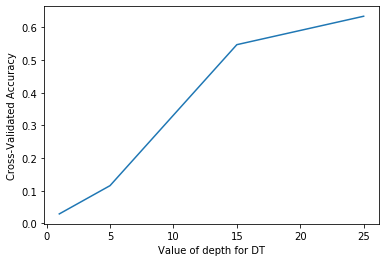

In [93]:
# plot the value of K for KNN (x-axis) versus the cross-validated accuracy (y-axis)
plt.plot(max_depth, k_scores)
plt.xlabel('Value of depth for DT')
plt.ylabel('Cross-Validated Accuracy')

In [94]:
DT = DecisionTreeClassifier(max_depth=25)

DT.fit(X_train, y_train)

y_pred=DT.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.81      0.72      0.76       121
           1       0.67      0.72      0.69        95
           2       0.90      0.91      0.91       113
           3       0.90      0.78      0.84        98
           4       0.85      0.84      0.84       119
           5       0.70      0.64      0.67       118
           6       0.95      0.94      0.94       117
           7       0.83      0.83      0.83       116
           8       0.90      0.88      0.89       111
           9       0.85      0.79      0.82       124
          10       0.65      0.68      0.67       125
          11       0.86      0.85      0.85       118
          12       0.77      0.83      0.80       105
          13       0.75      0.73      0.74        98
          14       0.83      0.80      0.82       107
          15       0.95      0.88      0.91       123
          16       0.90      0.92      0.91       120
          17       0.84    

In [95]:
#https://scikit-learn.org/stable/modules/generated/sklearn.tree.export_graphviz.html
import pydotplus
from sklearn.tree import export_graphviz
from IPython.display import Image
from sklearn.externals.six import StringIO

dot_data = StringIO()

export_graphviz(DT, out_file=dot_data, filled=True, rounded=True, special_characters=True, feature_names=X_train.columns,rotate=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.296902 to fit



# Model 6 : Ensemble Techniques 

## A. Bagging

# Classification Report

In [96]:
from sklearn.ensemble import RandomForestClassifier
RF=RandomForestClassifier(max_depth=50,n_estimators=100,class_weight='balanced')
RF.fit(X_train, y_train)

y_pred=RF.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.86      0.89      0.88       121
           1       0.81      0.89      0.85        95
           2       0.92      0.97      0.94       113
           3       0.90      0.81      0.85        98
           4       0.96      0.95      0.95       119
           5       0.92      0.77      0.84       118
           6       0.97      0.97      0.97       117
           7       0.93      0.93      0.93       116
           8       0.95      0.95      0.95       111
           9       0.91      0.87      0.89       124
          10       0.87      0.83      0.85       125
          11       0.93      0.96      0.95       118
          12       0.94      0.96      0.95       105
          13       0.82      0.84      0.83        98
          14       0.93      0.93      0.93       107
          15       0.98      0.97      0.98       123
          16       0.97      0.96      0.97       120
          17       0.94    

# Boosting

In [97]:
from sklearn.ensemble import GradientBoostingClassifier
GBDT=GradientBoostingClassifier(max_depth=5,n_estimators=100)
GBDT.fit(X_train, y_train)
y_pred=GBDT.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.82      0.85       121
           1       0.73      0.84      0.78        95
           2       0.92      0.96      0.94       113
           3       0.82      0.79      0.80        98
           4       0.91      0.90      0.91       119
           5       0.82      0.80      0.81       118
           6       0.97      0.92      0.95       117
           7       0.93      0.89      0.91       116
           8       0.98      0.94      0.96       111
           9       0.88      0.81      0.85       124
          10       0.77      0.81      0.79       125
          11       0.93      0.85      0.88       118
          12       0.92      0.91      0.92       105
          13       0.82      0.82      0.82        98
          14       0.90      0.88      0.89       107
          15       0.98      0.95      0.97       123
          16       0.96      0.93      0.95       120
          17       0.92    

# Stacking

## Tried using SGDclassifier with different types of loss 

In [99]:
from mlxtend.classifier import StackingClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

In [100]:
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.SGDClassifier.html
clf1 = SGDClassifier(alpha=0.001, penalty='l2', loss='log', class_weight='balanced', random_state=0)
clf1.fit(X_train, y_train)
sig_clf1 = CalibratedClassifierCV(clf1, method="sigmoid")

clf2 = SGDClassifier(alpha=1, penalty='l2', loss='hinge', class_weight='balanced', random_state=0)
clf2.fit(X_train, y_train)
sig_clf2 = CalibratedClassifierCV(clf2, method="sigmoid")


clf3 = MultinomialNB(alpha=0.001)
clf3.fit(X_train, y_train)
sig_clf3 = CalibratedClassifierCV(clf3, method="sigmoid")

sig_clf1.fit(X_train, y_train)
#print("Logistic Regression :  Log Loss: %0.2f" % (log_loss(cv_y, sig_clf1.predict_proba(cv_x_onehotCoding))))
sig_clf2.fit(X_train, y_train)
#print("Support vector machines : Log Loss: %0.2f" % (log_loss(cv_y, sig_clf2.predict_proba(cv_x_onehotCoding))))
sig_clf3.fit(X_train, y_train)
#print("Naive Bayes : Log Loss: %0.2f" % (log_loss(cv_y, sig_clf3.predict_proba(cv_x_onehotCoding))))
print("-"*50)
alpha = [0.0001,0.001,0.01,0.1,1,10] 
best_alpha = 999
for i in alpha:
    lr = LogisticRegression(C=i)
    sclf = StackingClassifier(classifiers=[sig_clf1, sig_clf2, sig_clf3], meta_classifier=lr, use_probas=True)
    sclf.fit(X_train, y_train)
    print("Stacking Classifer : for the value of alpha: %f Log Loss: %0.3f" % (i, log_loss(y_test, sclf.predict_proba(X_test))))
    log_error =log_loss(y_test, sclf.predict_proba(X_test))
    if best_alpha > log_error:
        best_alpha = log_error

--------------------------------------------------
Stacking Classifer : for the value of alpha: 0.000100 Log Loss: 3.989
Stacking Classifer : for the value of alpha: 0.001000 Log Loss: 3.987
Stacking Classifer : for the value of alpha: 0.010000 Log Loss: 3.969
Stacking Classifer : for the value of alpha: 0.100000 Log Loss: 3.817
Stacking Classifer : for the value of alpha: 1.000000 Log Loss: 3.309
Stacking Classifer : for the value of alpha: 10.000000 Log Loss: 2.551


In [101]:
lr = LogisticRegression(C=10)
sclf = StackingClassifier(classifiers=[sig_clf1, sig_clf2, sig_clf3], meta_classifier=lr, use_probas=True)
sclf.fit(X_train, y_train)


y_pred=sclf.predict(X_test)
print(classification_report(y_test, y_pred)) 
print(accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.45      0.59      0.51       121
           1       0.15      0.19      0.17        95
           2       0.35      0.44      0.39       113
           3       0.70      0.31      0.43        98
           4       0.81      0.22      0.34       119
           5       0.37      0.08      0.14       118
           6       0.55      0.49      0.52       117
           7       0.58      0.56      0.57       116
           8       0.50      0.70      0.58       111
           9       0.42      0.73      0.54       124
          10       0.34      0.15      0.21       125
          11       0.56      0.42      0.48       118
          12       0.35      0.80      0.49       105
          13       0.23      0.54      0.32        98
          14       0.53      0.64      0.58       107
          15       0.66      0.82      0.73       123
          16       0.36      0.45      0.40       120
          17       0.31    

# 6.Model Comparison

In [103]:
#https://stackoverflow.com/questions/18601688/python-prettytable-example

from prettytable import PrettyTable
table = PrettyTable()

#setting column names
table.field_names = [ "Sr.No","Model", "Accuracy"]

#setting row values
table.add_row(['1',"KNN", '64.33' ])
table.add_row(['2',"Naive Bayes",'24.66'  ])
table.add_row(['3',"Logistic Regression", '42.72' ])
table.add_row(['4',"SVM", '86.91' ])
table.add_row(['5',"Decision Tree",'79.85'  ])
table.add_row(['6',"RandomForest",'90.65'  ])
table.add_row(['7',"GBDT",'85.87'  ])
table.add_row(['9',"Stacking", '37.85' ])
print(table)

+-------+---------------------+----------+
| Sr.No |        Model        | Accuracy |
+-------+---------------------+----------+
|   1   |         KNN         |  64.33   |
|   2   |     Naive Bayes     |  24.66   |
|   3   | Logistic Regression |  42.72   |
|   4   |         SVM         |  86.91   |
|   5   |    Decision Tree    |  79.85   |
|   6   |     RandomForest    |  90.65   |
|   7   |         GBDT        |  85.87   |
|   9   |       Stacking      |  37.85   |
+-------+---------------------+----------+


# 7.Creating Submission File

In [104]:
best_model=RF
from sklearn.externals import joblib
filename = 'finalized_model.sav'
joblib.dump(best_model, filename)

['finalized_model.sav']